___

#### Rick Fontenot
___


In [2]:
# Imports
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from datetime import date
import sklearn
pd.set_option("display.max_columns", None, "display.max_rows", None)
import missingno as msno


### Load the raw data


In [3]:
internet_logs=pd.read_csv("https://raw.githubusercontent.com/rickfontenot/QTW/main/Case%20Study%205/log2.csv")

internet_logs.head()

,Source Port,Destination Port,NAT Source Port,NAT Destination Port,Action,Bytes,Bytes Sent,Bytes Received,Packets,Elapsed Time (sec),pkts_sent,pkts_received
0,57222,53,54587,53,allow,177,94,83,2,30,1,1
1,56258,3389,56258,3389,allow,4768,1600,3168,19,17,10,9
2,6881,50321,43265,50321,allow,238,118,120,2,1199,1,1
3,50553,3389,50553,3389,allow,3327,1438,1889,15,17,8,7
4,50002,443,45848,443,allow,25358,6778,18580,31,16,13,18


In [4]:
internet_logs.shape

(65532, 12)

In [5]:
internet_logs.Action.groupby(internet_logs.Action).count()


Action
allow         37640
deny          14987
drop          12851
reset-both       54
Name: Action, dtype: int64

## The action "reset-both" only has 54 observations, it will be removed to make this a 3-class prediction problem

In [6]:
internet_logs = internet_logs[internet_logs.Action != "reset-both"]
internet_logs.shape


(65478, 12)

In [7]:
# Check for duplicate rows
print('Duplicate rows: ',internet_logs.duplicated(keep='first').sum())

Duplicate rows:  8362


## Note there are 8,362 duplicate observations, only the first will be kept

In [8]:
logs_no_duplicates = internet_logs.drop_duplicates(keep='first')

In [9]:
logs_no_duplicates.shape

(57116, 12)

In [10]:
logs_no_duplicates.isna().sum()

Source Port             0
Destination Port        0
NAT Source Port         0
NAT Destination Port    0
Action                  0
Bytes                   0
Bytes Sent              0
Bytes Received          0
Packets                 0
Elapsed Time (sec)      0
pkts_sent               0
pkts_received           0
dtype: int64

In [11]:
logs_no_duplicates.Action.groupby(logs_no_duplicates.Action).count()


Action
allow    37439
deny      8042
drop     11635
Name: Action, dtype: int64

## There are no missing values that need to be imputed or removed

In [12]:
logs_no_duplicates.columns = logs_no_duplicates.columns.str.replace(r" ", "_")


In [13]:
logs_no_duplicates.dtypes

Source_Port              int64
Destination_Port         int64
NAT_Source_Port          int64
NAT_Destination_Port     int64
Action                  object
Bytes                    int64
Bytes_Sent               int64
Bytes_Received           int64
Packets                  int64
Elapsed_Time_(sec)       int64
pkts_sent                int64
pkts_received            int64
dtype: object

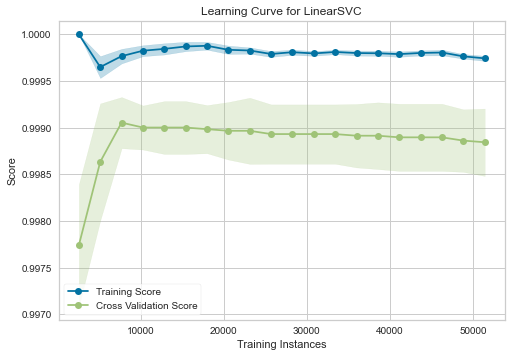

<AxesSubplot:title={'center':'Learning Curve for LinearSVC'}, xlabel='Training Instances', ylabel='Score'>

In [ ]:
from sklearn.svm import LinearSVC

from yellowbrick.model_selection import LearningCurve
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.model_selection import StratifiedKFold


X = logs_no_duplicates.drop(['Action'],axis=1).values
y = logs_no_duplicates.Action.values


# Encode the categorical data
X = OneHotEncoder().fit_transform(X)
y = LabelEncoder().fit_transform(y)

# Create the learning curve visualizer
cv = StratifiedKFold(n_splits=10)
sizes = np.linspace(0.05, 1.0, 20)

# Instantiate the classification model and visualizer
model = LinearSVC()
visualizer = LearningCurve(
    model, cv=cv, scoring='accuracy', train_sizes=sizes, n_jobs=4
)

visualizer.fit(X, y)        # Fit the data to the visualizer
visualizer.show()           # Finalize and render the figure

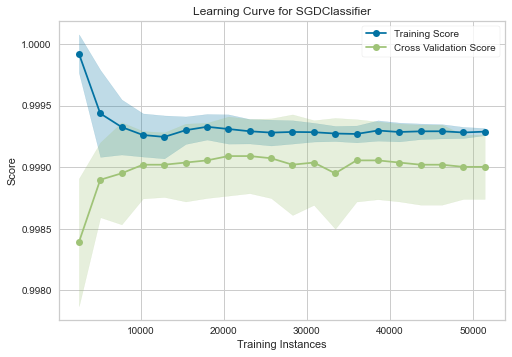

<AxesSubplot:title={'center':'Learning Curve for SGDClassifier'}, xlabel='Training Instances', ylabel='Score'>

In [ ]:
from sklearn.linear_model import SGDClassifier

X = logs_no_duplicates.drop(['Action'],axis=1).values
y = logs_no_duplicates.Action.values

# Encode the categorical data
X = OneHotEncoder().fit_transform(X)
y = LabelEncoder().fit_transform(y)

# Create the learning curve visualizer
cv = StratifiedKFold(n_splits=10)
sizes = np.linspace(0.05, 1, 20)

# Instantiate the classification model and visualizer
model = SGDClassifier()
visualizer = LearningCurve(
    model, cv=cv, scoring='accuracy', train_sizes=sizes, n_jobs=4
)

visualizer.fit(X, y)        # Fit the data to the visualizer
visualizer.show()           # Finalize and render the figure

## These initial learning Curves show that training size of 35,000 observations should be sufficient (cv score flattens out) Since Support Vectors can bog down with larger sample sizes this info can be used to limit effects on memory limits.

## Split data into training = 60% , validation = 20%, test = 20%

## Use stratified shuffle split for training, validation, and test sets

In [14]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.4, random_state=42)
for train_index, holdback_index in split.split(logs_no_duplicates, logs_no_duplicates.Action):
    training_df = logs_no_duplicates.iloc[train_index]
    holdback_df = logs_no_duplicates.iloc[holdback_index]

In [15]:
print("Size of training set: ",training_df.shape)
print("Size of hold back set to be split into validation/test: ",holdback_df.shape)

Size of training set:  (34269, 12)
Size of hold back set to be split into validation/test:  (22847, 12)


In [16]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.5, random_state=42)
for validation_index, test_index in split.split(holdback_df, holdback_df.Action):
    validation_df = holdback_df.iloc[validation_index]
    test_df = holdback_df.iloc[test_index]

In [17]:
print("Size of training set: ",training_df.shape)
print("Size of validation set: ",validation_df.shape)
print("Size of test set: ",test_df.shape)

Size of training set:  (34269, 12)
Size of validation set:  (11423, 12)
Size of test set:  (11424, 12)


In [18]:
training_df.head()

,Source_Port,Destination_Port,NAT_Source_Port,NAT_Destination_Port,Action,Bytes,Bytes_Sent,Bytes_Received,Packets,Elapsed_Time_(sec),pkts_sent,pkts_received
37603,58079,445,0,0,drop,66,66,0,1,0,1,0
40157,65216,53,59898,53,allow,244,94,150,2,30,1,1
35567,56415,443,20835,443,allow,6032,1722,4310,22,117,13,9
38225,50557,53,32584,53,allow,758,93,665,2,31,1,1
40019,57461,445,0,0,drop,66,66,0,1,0,1,0


In [19]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder, LabelEncoder


Numericals_to_scale = ['Bytes', 'Bytes_Sent','Bytes_Received', 'Packets', 'Elapsed_Time_(sec)', 'pkts_sent','pkts_received']

scl_obj = StandardScaler()
scl_obj.fit(training_df[Numericals_to_scale])
training_df[Numericals_to_scale] = scl_obj.transform(training_df[Numericals_to_scale])
validation_df[Numericals_to_scale] = scl_obj.transform(validation_df[Numericals_to_scale])
test_df[Numericals_to_scale] = scl_obj.transform(test_df[Numericals_to_scale])

training_df.Action = LabelEncoder().fit_transform(training_df.Action)
validation_df.Action = LabelEncoder().fit_transform(validation_df.Action)
test_df.Action = LabelEncoder().fit_transform(test_df.Action)


training_df.head()


/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/796339914.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  training_df[Numericals_to_scale] = scl_obj.transform(training_df[Numericals_to_scale])
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/796339914.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  validation_df[Numericals_to_scale] = scl_obj.transform(validation_df[Numericals_to_scale])
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/796339914.py:1

,Source_Port,Destination_Port,NAT_Source_Port,NAT_Destination_Port,Action,Bytes,Bytes_Sent,Bytes_Received,Packets,Elapsed_Time_(sec),pkts_sent,pkts_received
37603,58079,445,0,0,2,-0.034423,-0.010144,-0.033539,-0.039585,-0.237601,-0.039582,-0.036425
40157,65216,53,59898,53,0,-0.034352,-0.010102,-0.033476,-0.039156,-0.142918,-0.039582,-0.035844
35567,56415,443,20835,443,0,-0.032049,-0.007653,-0.031727,-0.030585,0.131664,-0.023604,-0.031191
38225,50557,53,32584,53,0,-0.034148,-0.010104,-0.033260,-0.039156,-0.139761,-0.039582,-0.035844
40019,57461,445,0,0,2,-0.034423,-0.010144,-0.033539,-0.039585,-0.237601,-0.039582,-0.036425


In [24]:
validation_df.head()

,Source_Port,Destination_Port,NAT_Source_Port,NAT_Destination_Port,Action,Bytes,Bytes_Sent,Bytes_Received,Packets,Elapsed_Time_(sec),pkts_sent,pkts_received
61065,45434,443,37816,443,allow,74123,16210,57913,106,57,52,54
40941,57202,445,0,0,drop,66,66,0,1,0,1,0
25792,65398,53,49816,53,allow,214,110,104,2,30,1,1
39733,51891,23238,33315,23238,allow,70,70,0,2,8,2,0
56002,56344,53,18094,53,allow,167,86,81,2,30,1,1


## Random Forest model as benchmark prior to SVM and SGD models

In [20]:
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score


scorer = {
    'accuracy': make_scorer(accuracy_score),
    'recall': make_scorer(recall_score),
    'precision': make_scorer(precision_score)
}

In [21]:
#Create new X predictor matrix for training
X_train = training_df.drop(['Action'],axis=1).values #droping target
y_train = training_df['Action'].values

#Create new X predictor matrix for validation
X_validation = validation_df.drop(['Action'],axis=1).values #droping target
y_validation = validation_df['Action'].values

#Create new X predictor matrix for test
X_test = test_df.drop(['Action'],axis=1).values #droping target
y_test = test_df['Action'].values


In [22]:
y_train.shape

(34269,)

In [83]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()

training_model = rf.fit(X_train,y_train)
rf_validation_predictions = training_model.predict(X_validation)

print(rf_validation_predictions)

from sklearn.metrics import classification_report
print(classification_report(y_validation,rf_validation_predictions, 
                            target_names=['allow','deny', 'drop']))
                            

[0 2 0 ... 0 0 0]
              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       1.00      0.99      1.00      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       1.00      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



In [84]:
print("Validation Set Accuracy: ", accuracy_score(y_validation, rf_validation_predictions))


Validation Set Accuracy:  0.9985993171671189


In [86]:
rf_test_predictions = training_model.predict(X_test)
print("Test Set Accuracy: ", accuracy_score(y_test, rf_test_predictions))


Test Set Accuracy:  0.9985994397759104


In [30]:
logs_no_duplicates.columns

Index(['Source_Port', 'Destination_Port', 'NAT_Source_Port',
       'NAT_Destination_Port', 'Action', 'Bytes', 'Bytes_Sent',
       'Bytes_Received', 'Packets', 'Elapsed_Time_(sec)', 'pkts_sent',
       'pkts_received'],
      dtype='object')

In [25]:
Categoricals_to_convert = ['Source_Port', 'Destination_Port', 'NAT_Source_Port', 'NAT_Destination_Port']
logs_no_duplicates[Categoricals_to_convert] = logs_no_duplicates [Categoricals_to_convert].astype(str)

# using pd get dummies for the category columns we are keeping
dummies = pd.get_dummies(logs_no_duplicates[Categoricals_to_convert],drop_first=True)

#concating dummies to the data frame
logs_no_duplicates_encoded = pd.concat([logs_no_duplicates,dummies],axis=1)

#dropping original columns
logs_no_duplicates_encoded = logs_no_duplicates_encoded.drop(Categoricals_to_convert,axis=1)


/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/1843790860.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  logs_no_duplicates[Categoricals_to_convert] = logs_no_duplicates [Categoricals_to_convert].astype(str)


In [26]:
logs_no_duplicates_encoded.shape


(57116, 57636)

In [27]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.4, random_state=42)
for train_index, holdback_index in split.split(logs_no_duplicates_encoded, logs_no_duplicates_encoded.Action):
    training_df_encoded = logs_no_duplicates_encoded.iloc[train_index]
    holdback_df_encoded = logs_no_duplicates_encoded.iloc[holdback_index]

print("Size of training set: ",training_df_encoded.shape)
print("Size of hold back set to be split into validation/test: ",holdback_df_encoded.shape)


Size of training set:  (34269, 57636)
Size of hold back set to be split into validation/test:  (22847, 57636)


In [28]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.5, random_state=42)
for validation_index, test_index in split.split(holdback_df_encoded, holdback_df_encoded.Action):
    validation_df_encoded = holdback_df_encoded.iloc[validation_index]
    test_df_encoded = holdback_df_encoded.iloc[test_index]

print("Size of training set: ",training_df_encoded.shape)
print("Size of validation set: ",validation_df_encoded.shape)
print("Size of test set: ",test_df_encoded.shape)


Size of training set:  (34269, 57636)
Size of validation set:  (11423, 57636)
Size of test set:  (11424, 57636)


In [29]:
from sklearn.preprocessing import StandardScaler

Numericals_to_scale = ['Bytes', 'Bytes_Sent','Bytes_Received', 'Packets', 'Elapsed_Time_(sec)', 'pkts_sent','pkts_received']

scl_obj = StandardScaler()
scl_obj.fit(training_df_encoded[Numericals_to_scale])
training_df_encoded[Numericals_to_scale] = scl_obj.transform(training_df_encoded[Numericals_to_scale])
validation_df_encoded[Numericals_to_scale] = scl_obj.transform(validation_df_encoded[Numericals_to_scale])
test_df_encoded[Numericals_to_scale] = scl_obj.transform(test_df_encoded[Numericals_to_scale])


/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/2804275531.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  training_df_encoded[Numericals_to_scale] = scl_obj.transform(training_df_encoded[Numericals_to_scale])
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/2804275531.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  validation_df_encoded[Numericals_to_scale] = scl_obj.transform(validation_df_encoded[Numericals_to_scale])
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn

In [30]:
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

training_df_encoded.Action = LabelEncoder().fit_transform(training_df_encoded.Action)
validation_df_encoded.Action = LabelEncoder().fit_transform(validation_df_encoded.Action)
test_df_encoded.Action = LabelEncoder().fit_transform(test_df_encoded.Action)

training_df_encoded.head()


/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/315344916.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  training_df_encoded.Action = LabelEncoder().fit_transform(training_df_encoded.Action)
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/315344916.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  validation_df_encoded.Action = LabelEncoder().fit_transform(validation_df_encoded.Action)
/var/folders/9j/md1p5ld92510j4f_fk49qf300000gn/T/ipykernel_59765/315344916.py:5: S

,Action,Bytes,Bytes_Sent,Bytes_Received,Packets,Elapsed_Time_(sec),pkts_sent,pkts_received,Source_Port_10000,Source_Port_10001,Source_Port_10002,Source_Port_10003,Source_Port_10004,Source_Port_10005,Source_Port_10006,Source_Port_10007,Source_Port_10008,Source_Port_10009,Source_Port_10010,Source_Port_10011,Source_Port_10012,Source_Port_10013,Source_Port_10014,Source_Port_10016,Source_Port_10018,Source_Port_10019,Source_Port_10022,Source_Port_10026,Source_Port_10028,Source_Port_10031,Source_Port_10034,Source_Port_10035,Source_Port_10036,Source_Port_10037,Source_Port_10038,Source_Port_10039,Source_Port_10047,Source_Port_10049,Source_Port_10050,Source_Port_10051,Source_Port_10052,Source_Port_10053,Source_Port_10056,Source_Port_10059,Source_Port_10060,Source_Port_10061,Source_Port_10063,Source_Port_10072,Source_Port_10075,Source_Port_10077,Source_Port_10079,Source_Port_10080,Source_Port_10082,Source_Port_10088,Source_Port_10089,Source_Port_10090,Source_Port_10091,Source_Port_10092,Source_Port_10097,Source_Port_10099,Source_Port_10101,Source_Port_10102,Source_Port_10103,Source_Port_10115,Source_Port_10125,Source_Port_10126,Source_Port_10128,Source_Port_10144,Source_Port_10145,Source_Port_10151,Source_Port_10164,Source_Port_10165,Source_Port_10166,Source_Port_10167,Source_Port_10168,Source_Port_10169,Source_Port_10192,Source_Port_10216,Source_Port_10218,Source_Port_1024,Source_Port_10243,Source_Port_10248,Source_Port_1025,Source_Port_10252,Source_Port_1026,Source_Port_10262,Source_Port_10265,Source_Port_1027,Source_Port_10273,Source_Port_1028,Source_Port_10283,Source_Port_1029,Source_Port_1030,Source_Port_10306,Source_Port_10307,Source_Port_10312,Source_Port_10319,Source_Port_10329,Source_Port_1033,Source_Port_10331,Source_Port_10333,Source_Port_1034,Source_Port_10344,Source_Port_10348,Source_Port_1035,Source_Port_10354,Source_Port_1036,Source_Port_10371,Source_Port_1038,Source_Port_10380,Source_Port_10381,Source_Port_1039,Source_Port_10390,Source_Port_10396,Source_Port_1040,Source_Port_10406,Source_Port_1041,Source_Port_10416,Source_Port_1042,Source_Port_10425,Source_Port_10427,Source_Port_1043,Source_Port_10430,Source_Port_10436,Source_Port_10438,Source_Port_1044,Source_Port_10445,Source_Port_10447,Source_Port_10448,Source_Port_1045,Source_Port_1046,Source_Port_10461,Source_Port_10462,Source_Port_10467,Source_Port_10477,Source_Port_1048,Source_Port_10480,Source_Port_1049,Source_Port_10494,Source_Port_10521,Source_Port_1053,Source_Port_10532,Source_Port_10533,Source_Port_1054,Source_Port_10540,Source_Port_10547,Source_Port_10552,Source_Port_1057,Source_Port_10570,Source_Port_1058,Source_Port_10586,Source_Port_1059,Source_Port_10594,Source_Port_10602,Source_Port_10627,Source_Port_1063,Source_Port_10632,Source_Port_10639,Source_Port_10652,Source_Port_1066,Source_Port_10669,Source_Port_1067,Source_Port_10688,Source_Port_1070,Source_Port_10701,Source_Port_10704,Source_Port_10736,Source_Port_10738,Source_Port_1074,Source_Port_10753,Source_Port_10754,Source_Port_10775,Source_Port_1078,Source_Port_10797,Source_Port_1080,Source_Port_10808,Source_Port_1081,Source_Port_10822,Source_Port_10833,Source_Port_10834,Source_Port_10844,Source_Port_10850,Source_Port_10860,Source_Port_10874,Source_Port_10886,Source_Port_1090,Source_Port_10903,Source_Port_10909,Source_Port_1091,Source_Port_10910,Source_Port_10914,Source_Port_10916,Source_Port_1092,Source_Port_10920,Source_Port_10921,Source_Port_10933,Source_Port_10947,Source_Port_10949,Source_Port_10963,Source_Port_10965,Source_Port_10976,Source_Port_10978,Source_Port_1100,Source_Port_11005,Source_Port_11006,Source_Port_1101,Source_Port_11020,Source_Port_11023,Source_Port_11028,Source_Port_11030,Source_Port_11044,Source_Port_11056,Source_Port_11061,Source_Port_11066,Source_Port_11073,Source_Port_11076,Source_Port_1108,Source_Port_11101,Source_Port_1111,Source_Port_11112,Source_Port_11133,Source_Port_11136,Source_Port_11139,Source_Port_1114,Source_Port_1116,Source_Port_1117,Source_Port_11228,Source_Port_

In [31]:
#Create new X predictor matrix for training
X_train_encoded = training_df_encoded.drop(['Action'],axis=1).values #droping target

#Create new X predictor matrix for validation
X_validation_encoded = validation_df_encoded.drop(['Action'],axis=1).values #droping target

#Create new X predictor matrix for validation
X_test_encoded = test_df_encoded.drop(['Action'],axis=1).values #droping target


In [32]:
print(X_train_encoded.shape)
print(X_validation_encoded.shape)
print(X_test_encoded.shape)

(34269, 57635)
(11423, 57635)
(11424, 57635)


Action Encoding:
0 = allow    (n=37439)
1 = deny     (n=8042)
2 = drop     (n=11635)

## LinearSVC Modeling

In [87]:
from sklearn.svm import LinearSVC

SVC_linear_base = LinearSVC()

training_model = SVC_linear_base.fit(X_train_encoded,y_train)
SVC_linear_base_validation_predictions = training_model.predict(X_validation_encoded)

print(SVC_linear_base_validation_predictions)

from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_linear_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[0 2 0 ... 0 0 0]
              precision    recall  f1-score   support

       allow       0.99      1.00      1.00      7488
        deny       1.00      0.96      0.98      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.99     11423
   macro avg       1.00      0.99      0.99     11423
weighted avg       0.99      0.99      0.99     11423



In [88]:
print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_linear_base_validation_predictions))


Validation Set Accuracy:  0.9940470979602556


In [37]:
print(SVC_linear_base.get_params())

{'C': 1.0, 'class_weight': None, 'dual': True, 'fit_intercept': True, 'intercept_scaling': 1, 'loss': 'squared_hinge', 'max_iter': 1000, 'multi_class': 'ovr', 'penalty': 'l2', 'random_state': None, 'tol': 0.0001, 'verbose': 0}


# Grid search for optimal parameters

In [38]:
from sklearn.model_selection import GridSearchCV

parameters = {'C':[1,10,100,1000], 'loss':['hinge', 'squared_hinge']}

clf = LinearSVC()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded, y_train)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)


Fitting 2 folds for each of 8 candidates, totalling 16 fits


/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of

Best Accuracy:  0.9973153340586732
Best Parameters:  {'C': 1, 'loss': 'hinge'}


Add second grid search with tol: float, default=1e-4 Tolerance for stopping criteria vs. max_iter: int, default=1000

In [41]:
from sklearn.model_selection import GridSearchCV

parameters = {'C':[1], 'loss':['hinge'], 'tol':[1e-6, 1e-4, 1e-2], 'max_iter':[1000, 2000, 5000]}

clf = LinearSVC()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded, y_train)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 9 candidates, totalling 18 fits


/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of

Best Accuracy:  0.9973153340586732
Best Parameters:  {'C': 1, 'loss': 'hinge', 'max_iter': 1000, 'tol': 1e-06}


In [89]:
SVC_linear_tuned = LinearSVC(C=1, loss='hinge', max_iter=1000, tol=1e-6)

training_model = SVC_linear_tuned.fit(X_train_encoded,y_train)
SVC_linear_tuned_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_linear_tuned_validation_predictions))


from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_linear_tuned_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

/opt/homebrew/Caskroom/miniforge/base/envs/boost/lib/python3.8/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Validation Set Accuracy:  0.9943097259914209
              precision    recall  f1-score   support

       allow       0.99      1.00      1.00      7488
        deny       1.00      0.96      0.98      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.99     11423
   macro avg       1.00      0.99      0.99     11423
weighted avg       0.99      0.99      0.99     11423



In [90]:
SVC_linear_tuned_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SVC_linear_tuned_test_predictions))



Test Set Accuracy:  0.9949229691876751


## SVC modeling with different kernels

Start by reducing the training size to speed up initial model selection

In [55]:
training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

from sklearn.svm import SVC

parameters = {'C': [0.1,1, 10],'kernel': ['rbf', 'poly', 'sigmoid']}

clf = SVC()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded_reduced, y_train_reduced)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 9 candidates, totalling 18 fits
Best Accuracy:  0.997
Best Parameters:  {'C': 10, 'kernel': 'rbf'}


In [58]:
#Use best params to get a check on validation accuracy

training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]


SVC_base = SVC(C=10,kernel='rbf')

training_model = SVC_base.fit(X_train_encoded_reduced,y_train_reduced)
SVC_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))


Validation Set Accuracy:  0.9973737196883481
              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       0.99      0.99      0.99      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       1.00      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



Run expanded search on more parameters while focsuing on the rbf kernel 

In [59]:
training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

from sklearn.svm import SVC

parameters = {'C': [1, 10],'kernel': ['rbf'],'gamma':['scale', 'auto'],'tol':[1e-6, 1e-3], 'max_iter':[-1],'decision_function_shape':['ovo', 'ovr']}

clf = SVC()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded_reduced, y_train_reduced)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 16 candidates, totalling 32 fits
Best Accuracy:  0.997
Best Parameters:  {'C': 10, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': -1, 'tol': 1e-06}


In [101]:
#Use best params to get a check on validation accuracy

from sklearn.svm import SVC

training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SVC_base = SVC(C=10, decision_function_shape='ovo', gamma='scale', kernel='rbf', tol= 1e-06)

training_model = SVC_base.fit(X_train_encoded_reduced,y_train_reduced)
SVC_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9973737196883481
              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       0.99      0.99      0.99      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       1.00      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



In [102]:
SVC_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SVC_base_test_predictions))



Test Set Accuracy:  0.9976365546218487


Now run the tuned model again with 10,000 training samples
It may be too time consuming to expand to the full 35,000 training set

In [103]:
#Use best params to get a check on validation accuracy

from sklearn.svm import SVC

training_samples=10000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SVC_base = SVC(C=10, decision_function_shape='ovo', gamma='scale', kernel='rbf', tol= 1e-06)

training_model = SVC_base.fit(X_train_encoded_reduced,y_train_reduced)
SVC_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9980740611047886
              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       1.00      0.99      0.99      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       1.00      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



In [104]:
SVC_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SVC_base_test_predictions))

Test Set Accuracy:  0.9979866946778712


In [105]:
#Use best params to get a check on validation accuracy

from sklearn.svm import SVC

training_samples=15000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SVC_base = SVC(C=10, decision_function_shape='ovo', gamma='scale', kernel='rbf', tol= 1e-06)

training_model = SVC_base.fit(X_train_encoded_reduced,y_train_reduced)
SVC_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SVC_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SVC_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9982491464588987
              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       1.00      0.99      0.99      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       1.00      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



In [106]:
SVC_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SVC_base_test_predictions))

Test Set Accuracy:  0.998686974789916


## Sklearn SGD Classifier

In [91]:
from sklearn.linear_model import SGDClassifier

training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SGD_base = SGDClassifier()

training_model = SGD_base.fit(X_train_encoded_reduced,y_train_reduced)
SGD_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SGD_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SGD_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9524643263591
              precision    recall  f1-score   support

       allow       1.00      0.93      0.96      7488
        deny       0.75      0.98      0.85      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.95     11423
   macro avg       0.92      0.97      0.94     11423
weighted avg       0.96      0.95      0.95     11423



In [92]:
SGD_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SGD_base_test_predictions))


Test Set Accuracy:  0.9541316526610645


In [93]:
from sklearn.linear_model import SGDClassifier

training_samples=10000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SGD_base = SGDClassifier()

training_model = SGD_base.fit(X_train_encoded_reduced,y_train_reduced)
SGD_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SGD_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SGD_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9627943622515976
              precision    recall  f1-score   support

       allow       1.00      0.95      0.97      7488
        deny       0.80      0.99      0.88      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.96     11423
   macro avg       0.93      0.98      0.95     11423
weighted avg       0.97      0.96      0.96     11423



In [94]:
SGD_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SGD_base_test_predictions))

Test Set Accuracy:  0.9648984593837535


In [95]:
from sklearn.linear_model import SGDClassifier

training_samples=15000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

SGD_base = SGDClassifier()

training_model = SGD_base.fit(X_train_encoded_reduced,y_train_reduced)
SGD_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SGD_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SGD_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9816160378184365
              precision    recall  f1-score   support

       allow       1.00      0.97      0.99      7488
        deny       0.89      0.99      0.94      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.98     11423
   macro avg       0.96      0.99      0.97     11423
weighted avg       0.98      0.98      0.98     11423



In [96]:
SGD_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SGD_base_test_predictions))

Test Set Accuracy:  0.9816176470588235


In [97]:
from sklearn.linear_model import SGDClassifier

#Full training set

SGD_base = SGDClassifier()

training_model = SGD_base.fit(X_train_encoded,y_train)
SGD_base_validation_predictions = training_model.predict(X_validation_encoded)

print("Validation Set Accuracy: ", accuracy_score(y_validation, SGD_base_validation_predictions))

from sklearn.metrics import classification_report
print(classification_report(y_validation,SGD_base_validation_predictions, 
                            target_names=['allow','deny', 'drop']))

Validation Set Accuracy:  0.9933467565438151
              precision    recall  f1-score   support

       allow       0.99      1.00      1.00      7488
        deny       1.00      0.96      0.98      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           0.99     11423
   macro avg       1.00      0.98      0.99     11423
weighted avg       0.99      0.99      0.99     11423



In [98]:
SGD_base_test_predictions = training_model.predict(X_test_encoded)
print("Test Set Accuracy: ", accuracy_score(y_test, SGD_base_test_predictions))

Test Set Accuracy:  0.9944852941176471


Grid search to look at loss functions and regularization terms

In [51]:
from sklearn.model_selection import GridSearchCV

training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

from sklearn.svm import SVC

parameters = {
    'loss':['hinge'],
    'penalty':['l2'],
    'alpha':[0.00001, 0.0001, 0.001, 0.01],
}

clf = SGDClassifier()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded_reduced, y_train_reduced)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 4 candidates, totalling 8 fits
Best Accuracy:  0.9618
Best Parameters:  {'alpha': 1e-05, 'loss': 'hinge', 'penalty': 'l2'}


In [52]:
print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Best Accuracy:  0.9618
Best Parameters:  {'alpha': 1e-05, 'loss': 'hinge', 'penalty': 'l2'}


Using best loss function & regularization, perform next grid search to look at epochs and stopping

In [86]:
training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

from sklearn.svm import SVC

parameters = {
    "max_iter": [1000, 5000],
    "tol": [1e-3, 1e-1],
    "early_stopping": [True, False],
    "n_iter_no_change": [5,10]
}

clf = SGDClassifier()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded_reduced, y_train_reduced)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 16 candidates, totalling 32 fits
Best Accuracy:  0.974
Best Parameters:  {'early_stopping': False, 'max_iter': 5000, 'n_iter_no_change': 10, 'tol': 0.001}


In [88]:
training_samples=5000
X_train_encoded_reduced = X_train_encoded[1:training_samples+1,]
y_train_reduced = y_train[1:training_samples+1,]

from sklearn.svm import SVC

parameters = {
    "max_iter": [1000, 5000, 10000, 20000],
}

clf = SGDClassifier()

import warnings

with warnings.catch_warnings():
   warnings.simplefilter('ignore')
   grid_obj = GridSearchCV(clf, parameters, cv = 2, verbose=1, n_jobs = 6, scoring='accuracy')
   grid_obj = grid_obj.fit(X_train_encoded_reduced, y_train_reduced)

print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Fitting 2 folds for each of 4 candidates, totalling 8 fits
Best Accuracy:  0.9504
Best Parameters:  {'max_iter': 20000}


In [89]:
print("Best Accuracy: ",grid_obj.best_score_)
print("Best Parameters: ",grid_obj.best_params_)

Best Accuracy:  0.9504
Best Parameters:  {'max_iter': 20000}


## SGD modeling with Vowpal Wabbit

Below is modification of function shown by Dr. Slater in class to convert dataframe to VW format


In [43]:
training_df.Action.iloc[1:10]

40157    0
35567    0
38225    0
40019    2
12013    0
44104    0
9010     0
1959     0
42460    2
Name: Action, dtype: int64

In [134]:
def to_vw_format(row):
    res = f'{(round(row.Action))} |'
    for idx, value in row.drop(['Action']).iteritems():
        feature_name = idx.replace(' ','_').replace('(', '').replace(')', '')
        if "Port" in feature_name:
            res += f' {feature_name}_{round(value)}'
        else:
            res += f' {feature_name}:{value}'
    return res

In [135]:
for ex in training_df.head(10).apply(to_vw_format, axis=1):
    print(ex)
    

2 | Source_Port_58079 Destination_Port_445 NAT_Source_Port_0 NAT_Destination_Port_0 Bytes:-0.03442286777675774 Bytes_Sent:-0.010144428801491905 Bytes_Received:-0.033539300995677104 Packets:-0.03958456735494862 Elapsed_Time_sec:-0.23760094879516788 pkts_sent:-0.03958173543686822 pkts_received:-0.036425203621564595
0 | Source_Port_65216 Destination_Port_53 NAT_Source_Port_59898 NAT_Destination_Port_53 Bytes:-0.03435205074832443 Bytes_Sent:-0.010102300930506422 Bytes_Received:-0.0334762414977625 Packets:-0.039156000856202945 Elapsed_Time_sec:-0.14291754193944162 pkts_sent:-0.03958173543686822 pkts_received:-0.035843678229566016
0 | Source_Port_56415 Destination_Port_443 NAT_Source_Port_20835 NAT_Destination_Port_443 Bytes:-0.032049303778819045 Bytes_Sent:-0.007652866146064796 Bytes_Received:-0.03172739142226431 Packets:-0.030584670881289466 Elapsed_Time_sec:0.13166433794216453 pkts_sent:-0.023604023873619494 pkts_received:-0.03119147509357739
0 | Source_Port_50557 Destination_Port_53 NAT_

In [46]:
import vowpalwabbit

vw = vowpalwabbit.Workspace("--oaa 3 --quiet --cache --passes 2000 --loss_function hinge")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)


In [47]:
#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

In [48]:
print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))


Validation Set Accuracy:  0.9969360063030728


In [49]:
from sklearn.metrics import classification_report
print(classification_report(y_validation,vw_predictions, 
                            target_names=['allow','deny', 'drop']))

              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       0.99      0.99      0.99      1608
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11423
   macro avg       0.99      1.00      1.00     11423
weighted avg       1.00      1.00      1.00     11423



# Grid search for optimal parameters

In [50]:
# Explicitly calling --sgd increased accuracy 
vw = vowpalwabbit.Workspace("--oaa 3 --sgd --quiet --cache --passes 2000 --loss_function hinge")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))


Validation Set Accuracy:  0.9971986343342379


In [51]:
vw = vowpalwabbit.Workspace("--oaa 3 --sgd --quiet --cache --passes 2000 --loss_function hinge --l2 0.000001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9971986343342379


In [60]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 1 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9965858355948525


In [61]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 5 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.997286177011293


In [62]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 10 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9971986343342379


In [63]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 15 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9976363477195133


In [64]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 20 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9977238903965683


In [69]:
# -l is scaling the learning rate, default 10, when increased to 100 improved accuracy

vw = vowpalwabbit.Workspace("--oaa 3 --sgd -l 25 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9976363477195133


In [77]:
# adax adaptive learning rates with x^2 instead of g^2x^2

vw = vowpalwabbit.Workspace("--oaa 3 --adax -l 20 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9979865184277336


In [81]:
# adax adaptive learning rates with x^2 instead of g^2x^2

vw = vowpalwabbit.Workspace("--oaa 3 --adax -l 50 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in validation_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_validation, vw_predictions))

Validation Set Accuracy:  0.9979865184277336


In [82]:
# adax adaptive learning rates with x^2 instead of g^2x^2

vw = vowpalwabbit.Workspace("--oaa 3 --adax -l 50 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in test_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Validation Set Accuracy: ", accuracy_score(y_test, vw_predictions))

Validation Set Accuracy:  0.998249299719888


## Final Tuned VW SGD model

In [353]:
# adax adaptive learning rates with x^2 instead of g^2x^2

vw = vowpalwabbit.Workspace("--oaa 3 --adax -l 50 --quiet --cache --passes 2000 --loss_function hinge --l2 0.0001 --save_resume --readable_model vw_output.txt")
# learn from training set with multiple passes
for example in training_df.apply(to_vw_format, axis=1):
    vw.learn(example)

#predict from the testing set

vw_predictions = []
for example in test_df.apply(to_vw_format, axis=1):
    predicted_class = vw.predict(example)
    vw_predictions.append(predicted_class)

print("Test Set Accuracy: ", accuracy_score(y_test, vw_predictions))

Test Set Accuracy:  0.9983368347338936


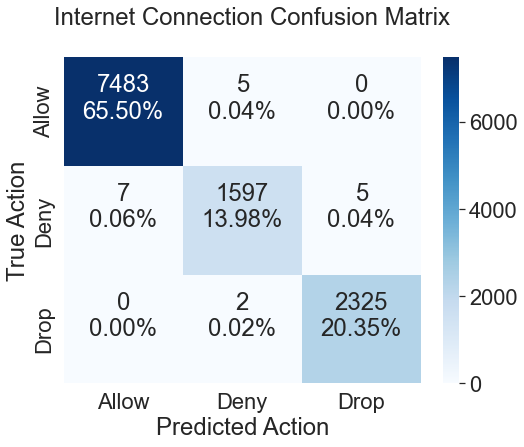

In [356]:
from sklearn.metrics import confusion_matrix

def plot_confusion(cf_matrix):
    plt.figure(figsize=(8, 6))
    sns.set(font_scale=2)
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ['{0:0.0f}'.format(value) for value in
    cf_matrix.flatten()]
    group_percentages = ['{0:.2%}'.format(value) for value in
    cf_matrix.flatten()/np.sum(cf_matrix)]
    labels = [f'{v1}\n{v2}\n' for v1, v2 in
    zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(3,3)
    x_axis_labels = ['Allow','Deny', 'Drop']
    y_axis_labels = ['Allow','Deny', 'Drop']
    ax = plt.axes()
    sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues',xticklabels=x_axis_labels, yticklabels=y_axis_labels)
    ax.set_title('   Internet Connection Confusion Matrix\n')
    plt.xlabel("Predicted Action")
    plt.ylabel("True Action") 


lr_cm = confusion_matrix(y_test,vw_predictions)
plot_confusion(lr_cm)

In [357]:
from sklearn.metrics import classification_report
print(classification_report(y_test,vw_predictions, 
                            target_names=['allow','deny', 'drop']))

              precision    recall  f1-score   support

       allow       1.00      1.00      1.00      7488
        deny       1.00      0.99      0.99      1609
        drop       1.00      1.00      1.00      2327

    accuracy                           1.00     11424
   macro avg       1.00      1.00      1.00     11424
weighted avg       1.00      1.00      1.00     11424



<AxesSubplot:>

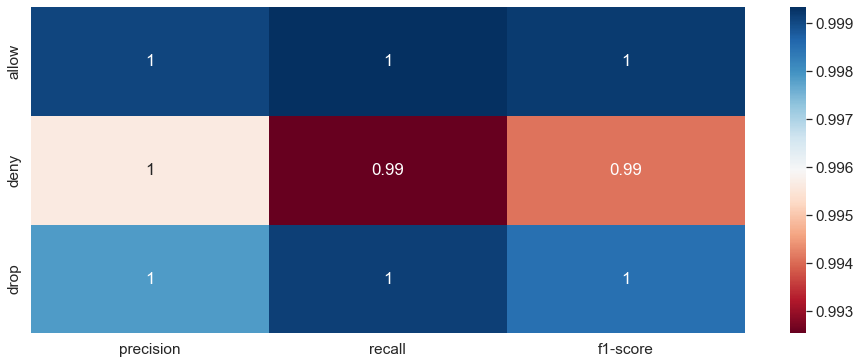

In [358]:
labels = np.arange(3) # This is for the fine level, will have to adjust to class numbers for medium and fine level plots

# https://stackoverflow.com/questions/28200786/how-to-plot-scikit-learn-classification-report
clf_report = classification_report(y_test, vw_predictions, labels=labels, target_names=['allow','deny', 'drop'],output_dict=True)


# .iloc[:-1, :] to exclude support
sns.set(font_scale=1.4)
sns.heatmap(pd.DataFrame(clf_report).iloc[:-1, :-3].T, annot=True, cmap='RdBu')

## Feature Importance using weights from VW SGD model

In [163]:
weights = pd.DataFrame([(name, vw.get_weight_from_name(name)) for name in training_df_encoded.columns])
weights = weights.rename(columns={weights.columns[0]: 'feature'})
weights = weights.rename(columns={weights.columns[1]: 'weight'})
weights = weights.sort_values(by='weight', key=abs, ascending=False)

weights.head(20)


,feature,weight
19935,Source_Port_63057,2.103178
34763,NAT_Source_Port_28327,-2.057491
27996,NAT_Source_Port_14268,-2.057491
1905,Source_Port_27442,-2.030668
24289,Destination_Port_37610,-1.974175
8486,Source_Port_50031,1.967583
35867,NAT_Source_Port_30545,-1.967231
34066,NAT_Source_Port_26945,1.957565
11050,Source_Port_52797,-1.910680
56155,NAT_Destination_Port_32975,-1.910680


In [197]:
weights.shape

(57636, 2)

In [166]:
training_df_encoded['Source_Port_63057'].groupby(training_df_encoded.Action).count()


Action
0    22463
1     4825
2     6981
Name: Source_Port_63057, dtype: int64

In [188]:


newdf = training_df[(training_df.Source_Port == 50031)]
newdf.head()


,Source_Port,Destination_Port,NAT_Source_Port,NAT_Destination_Port,Action,Bytes,Bytes_Sent,Bytes_Received,Packets,Elapsed_Time_(sec),pkts_sent,pkts_received
62132,50031,53,36003,53,0,-0.034296,-0.010042,-0.033433,-0.039156,-0.142918,-0.039582,-0.035844
53577,50031,44847,0,0,1,-0.034420,-0.010132,-0.033539,-0.039585,-0.237601,-0.039582,-0.036425
4249,50031,445,0,0,2,-0.034423,-0.010144,-0.033539,-0.039585,-0.237601,-0.039582,-0.036425
2189,50031,53,6210,53,0,-0.034377,-0.010102,-0.033503,-0.039156,-0.142918,-0.039582,-0.035844
1500,50031,53,53719,53,0,-0.034378,-0.010107,-0.033503,-0.039156,-0.139761,-0.039582,-0.035844


In [209]:

port_counts = pd.DataFrame(training_df_encoded.sum(axis=0))
port_counts.reset_index(inplace=True)
port_counts = port_counts.rename(columns={port_counts.columns[0]: 'feature'})
port_counts = port_counts.rename(columns={port_counts.columns[1]: 'count'})
port_counts = port_counts.sort_values(by='count', key=abs, ascending=False)


port_counts.head(50)

,feature,count
0,Action,18787.0
25177,Destination_Port_53,9224.0
57063,NAT_Destination_Port_53,9047.0
24663,Destination_Port_443,7031.0
56667,NAT_Destination_Port_443,7028.0
24673,Destination_Port_445,7006.0
25850,Destination_Port_80,2436.0
57562,NAT_Destination_Port_80,2431.0
23518,Destination_Port_25174,411.0
1836,Source_Port_27005,300.0


In [198]:
port_counts.shape

(57636, 2)

In [199]:
weights_counts = weights.merge(port_counts, left_on='feature', right_on='feature')
weights_counts.head()

,feature,weight,count
0,Source_Port_63057,2.103178,2.0
1,NAT_Source_Port_28327,-2.057491,1.0
2,NAT_Source_Port_14268,-2.057491,1.0
3,Source_Port_27442,-2.030668,1.0
4,Destination_Port_37610,-1.974175,1.0


# Biggest weights are from ports with small sample size
# Re-examine for ports with > 10 observations

In [247]:

weights_min_samples = weights_counts[(weights_counts['count'] > 10)]
weights_min_samples = weights_min_samples.sort_values(by='weight', key=abs, ascending=False)

weights_min_samples.head(10)

,feature,weight,count
978,Destination_Port_51413,-0.042841,44.0
1163,NAT_Destination_Port_80,-0.033868,2431.0
1711,Destination_Port_37965,-0.017310,204.0
1900,NAT_Source_Port_48817,-0.014495,44.0
1935,Destination_Port_51050,-0.014073,27.0
2113,Destination_Port_31573,-0.012116,23.0
2261,Destination_Port_993,-0.010910,23.0
2622,Source_Port_65189,-0.008528,22.0
3282,Destination_Port_55442,-0.004358,13.0
3368,Destination_Port_15000,-0.003989,48.0


In [260]:
top_10_features = list(weights_min_samples.head(10).feature)
top_10_features

['Destination_Port_51413',
 'NAT_Destination_Port_80',
 'Destination_Port_37965',
 'NAT_Source_Port_48817',
 'Destination_Port_51050',
 'Destination_Port_31573',
 'Destination_Port_993',
 'Source_Port_65189',
 'Destination_Port_55442',
 'Destination_Port_15000']

# For top 10 features, calculate & plot actions taken for each one

In [277]:
action_counts = pd.DataFrame(training_df.Action.groupby(training_df.Action).count())
action_counts = action_counts.rename(columns={action_counts.columns[0]: 'All_Ports'})
action_counts.reset_index(inplace=True)
action_counts.head()


,Action,All_Ports
0,0,22463
1,1,4825
2,2,6981


In [295]:
Destination_Port_51413  = training_df[(training_df.Destination_Port == 51413)]
Destination_Port_51413_actions = pd.DataFrame(Destination_Port_51413.Action.groupby(Destination_Port_51413.Action).count())
Destination_Port_51413_actions = Destination_Port_51413_actions.rename(columns={Destination_Port_51413_actions.columns[0]: 'Destination_Port_51413'})
Destination_Port_51413_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_51413_actions, how='left')

NAT_Destination_Port_80	 = training_df[(training_df.NAT_Destination_Port == 80)]
NAT_Destination_Port_80_actions = pd.DataFrame(NAT_Destination_Port_80.Action.groupby(NAT_Destination_Port_80.Action).count())
NAT_Destination_Port_80_actions = NAT_Destination_Port_80_actions.rename(columns={NAT_Destination_Port_80_actions.columns[0]: 'NAT_Destination_Port_80'})
NAT_Destination_Port_80_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, NAT_Destination_Port_80_actions, how='left')

Destination_Port_37965  = training_df[(training_df.Destination_Port == 37965)]
Destination_Port_37965_actions = pd.DataFrame(Destination_Port_37965.Action.groupby(Destination_Port_37965.Action).count())
Destination_Port_37965_actions = Destination_Port_37965_actions.rename(columns={Destination_Port_37965_actions.columns[0]: 'Destination_Port_37965'})
Destination_Port_37965_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_37965_actions, how='left')

NAT_Source_Port_48817  = training_df[(training_df.NAT_Source_Port == 48817)]
NAT_Source_Port_48817_actions = pd.DataFrame(NAT_Source_Port_48817.Action.groupby(NAT_Source_Port_48817.Action).count())
NAT_Source_Port_48817_actions = NAT_Source_Port_48817_actions.rename(columns={NAT_Source_Port_48817_actions.columns[0]: 'NAT_Source_Port_48817'})
NAT_Source_Port_48817_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, NAT_Source_Port_48817_actions, how='left')

Destination_Port_51050  = training_df[(training_df.Destination_Port == 51050)]
Destination_Port_51050_actions = pd.DataFrame(Destination_Port_51050.Action.groupby(Destination_Port_51050.Action).count())
Destination_Port_51050_actions = Destination_Port_51050_actions.rename(columns={Destination_Port_51050_actions.columns[0]: 'Destination_Port_51050'})
Destination_Port_51050_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_51050_actions, how='left')

Destination_Port_31573  = training_df[(training_df.Destination_Port == 31573)]
Destination_Port_31573_actions = pd.DataFrame(Destination_Port_31573.Action.groupby(Destination_Port_31573.Action).count())
Destination_Port_31573_actions = Destination_Port_31573_actions.rename(columns={Destination_Port_31573_actions.columns[0]: 'Destination_Port_31573'})
Destination_Port_31573_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_31573_actions, how='left')

Destination_Port_993  = training_df[(training_df.Destination_Port == 993)]
Destination_Port_993_actions = pd.DataFrame(Destination_Port_993.Action.groupby(Destination_Port_993.Action).count())
Destination_Port_993_actions = Destination_Port_993_actions.rename(columns={Destination_Port_993_actions.columns[0]: 'Destination_Port_993'})
Destination_Port_993_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_993_actions, how='left')

Source_Port_65189  = training_df[(training_df.Source_Port == 65189)]
Source_Port_65189_actions = pd.DataFrame(Source_Port_65189.Action.groupby(Source_Port_65189.Action).count())
Source_Port_65189_actions = Source_Port_65189_actions.rename(columns={Source_Port_65189_actions.columns[0]: 'Source_Port_65189'})
Source_Port_65189_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Source_Port_65189_actions, how='left')

Destination_Port_55442  = training_df[(training_df.Destination_Port == 55442)]
Destination_Port_55442_actions = pd.DataFrame(Destination_Port_55442.Action.groupby(Destination_Port_55442.Action).count())
Destination_Port_55442_actions = Destination_Port_55442_actions.rename(columns={Destination_Port_55442_actions.columns[0]: 'Destination_Port_55442'})
Destination_Port_55442_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_55442_actions, how='left')

Destination_Port_15000  = training_df[(training_df.Destination_Port == 15000)]
Destination_Port_15000_actions = pd.DataFrame(Destination_Port_15000.Action.groupby(Destination_Port_15000.Action).count())
Destination_Port_15000_actions = Destination_Port_15000_actions.rename(columns={Destination_Port_15000_actions.columns[0]: 'Destination_Port_15000'})
Destination_Port_15000_actions.reset_index(inplace=True)
action_counts = pd.merge(action_counts, Destination_Port_15000_actions, how='left')

action_counts = action_counts.fillna(0)    

action_counts.head()


,Action,All_Ports,NAT_Destination_Port_80,Destination_Port_51413,Destination_Port_37965,NAT_Source_Port_48817,Destination_Port_51050,Destination_Port_31573,Destination_Port_993,Source_Port_65189,Destination_Port_55442,Destination_Port_15000
0,0,22463,2431.0,44.0,0.0,44.0,0.0,0.0,23.0,22.0,0.0,48.0
1,1,4825,0.0,0.0,204.0,0.0,27.0,23.0,0.0,0.0,13.0,0.0
2,2,6981,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [300]:
actions_long = pd.melt(action_counts,id_vars='Action')
actions_long.head()

,Action,variable,value
0,0,All_Ports,22463.0
1,1,All_Ports,4825.0
2,2,All_Ports,6981.0
3,0,NAT_Destination_Port_80,2431.0
4,1,NAT_Destination_Port_80,0.0


In [319]:
action_counts_transposed = action_counts.T
action_counts_transposed = action_counts_transposed.rename(columns={action_counts_transposed.columns[0]: 'Allow'})
action_counts_transposed = action_counts_transposed.rename(columns={action_counts_transposed.columns[1]: 'Deny'})
action_counts_transposed = action_counts_transposed.rename(columns={action_counts_transposed.columns[2]: 'Drop'})
action_counts_transposed.reset_index(inplace=True)
action_counts_transposed = action_counts_transposed.drop(labels=0, axis=0)
action_counts_transposed.head()


,index,Allow,Deny,Drop
1,All_Ports,22463.0,4825.0,6981.0
2,NAT_Destination_Port_80,2431.0,0.0,0.0
3,Destination_Port_51413,44.0,0.0,0.0
4,Destination_Port_37965,0.0,204.0,0.0
5,NAT_Source_Port_48817,44.0,0.0,0.0


In [326]:
action_counts_normalized = action_counts_transposed.set_index('index')
action_counts_normalized = action_counts_normalized.div(action_counts_normalized.sum(axis=1), axis=0)*100
action_counts_normalized.head()



,Allow,Deny,Drop
index,,,
All_Ports,65.549038,14.079781,20.371181
NAT_Destination_Port_80,100.000000,0.000000,0.000000
Destination_Port_51413,100.000000,0.000000,0.000000
Destination_Port_37965,0.000000,100.000000,0.000000
NAT_Source_Port_48817,100.000000,0.000000,0.000000


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 [Text(0, 0, 'All_Ports'),
  Text(1, 0, 'NAT_Destination_Port_80'),
  Text(2, 0, 'Destination_Port_51413'),
  Text(3, 0, 'Destination_Port_37965'),
  Text(4, 0, 'NAT_Source_Port_48817'),
  Text(5, 0, 'Destination_Port_51050'),
  Text(6, 0, 'Destination_Port_31573'),
  Text(7, 0, 'Destination_Port_993'),
  Text(8, 0, 'Source_Port_65189'),
  Text(9, 0, 'Destination_Port_55442'),
  Text(10, 0, 'Destination_Port_15000')])

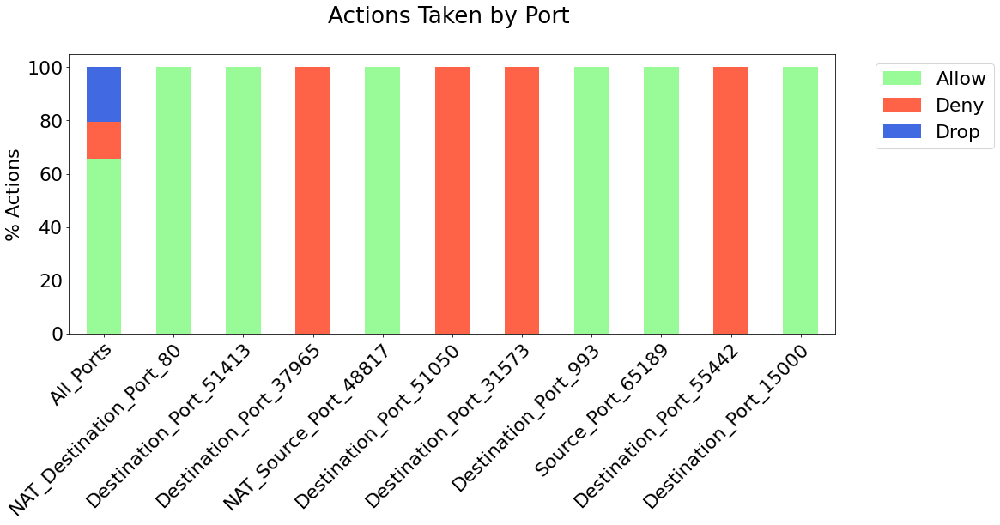

In [352]:
plt.rcParams["figure.figsize"] = (16,6)
plt.rcParams.update({'font.size': 22})
action_counts_normalized.plot.bar(stacked=True, color=['palegreen', 'tomato', 'royalblue'])
plt.title('Actions Taken by Port \n')
plt.xlabel('')
plt.ylabel('% Actions')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.xticks(rotation = 45, ha='right', rotation_mode='anchor') # Rotates X-Axis Ticks by 45-degrees


